Found 8 classes:
- adm (5001 images)
- biggan (5002 images)
- general (59991 images)
- glide (5000 images)
- midjourney (5000 images)
- sdv5 (5000 images)
- vqdm (5000 images)
- wukong (5002 images)


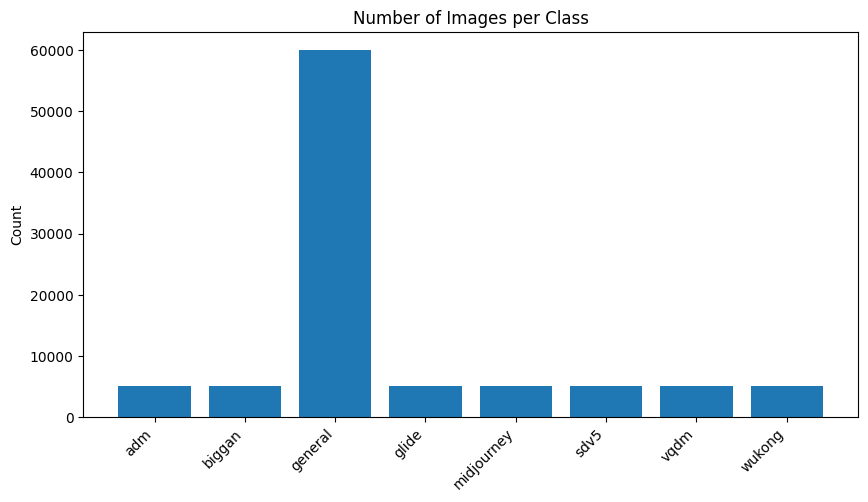

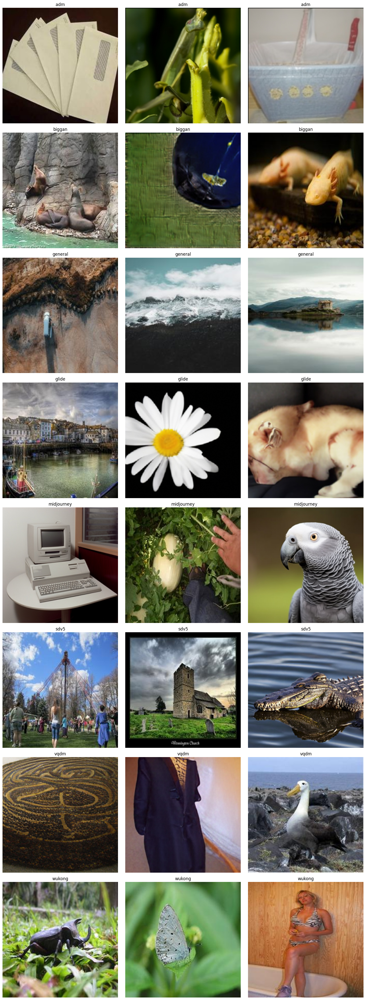

Found 9 corrupted images.
Examples: ['../data/standardized_jpg/adm/.DS_Store', '../data/standardized_jpg/adm/train/.DS_Store', '../data/standardized_jpg/biggan/.DS_Store', '../data/standardized_jpg/biggan/val/.DS_Store', '../data/standardized_jpg/general/.DS_Store', '../data/standardized_jpg/general/train/.DS_Store', '../data/standardized_jpg/general/val/.DS_Store', '../data/standardized_jpg/wukong/.DS_Store', '../data/standardized_jpg/wukong/val/.DS_Store']
Average width: 512.00, height: 512.00
Most common resolution: [((512, 512), 1624)]


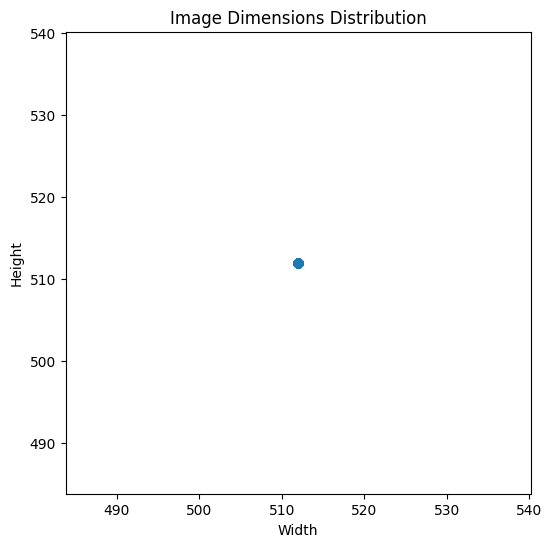

Dataset Mean: [0.48900708 0.46209622 0.40602369]
Dataset Std: [0.27639476 0.26932994 0.28221578]


In [1]:
# 1. Setup

import os
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
from collections import Counter
from PIL import Image, UnidentifiedImageError

# Adjust to dataset path
DATASET_DIR = "../data/standardized_jpg"

# 2. Inspect folder structure (skip hidden files)
classes = sorted([c for c in os.listdir(DATASET_DIR) if not c.startswith(".") and os.path.isdir(os.path.join(DATASET_DIR, c))])

print(f"Found {len(classes)} classes:")
for c in classes:
    num_files = sum([len(files) for r, d, files in os.walk(os.path.join(DATASET_DIR, c))])
    print(f"- {c} ({num_files} images)")

# 3. Count images per class (recursive)
class_counts = {}
for c in classes:
    count = sum([len(files) for r, d, files in os.walk(os.path.join(DATASET_DIR, c))])
    class_counts[c] = count

plt.figure(figsize=(10,5))
plt.bar(class_counts.keys(), class_counts.values())
plt.xticks(rotation=45, ha="right")
plt.title("Number of Images per Class")
plt.ylabel("Count")
plt.show()

# 4. Show random samples per class
def show_samples(classes, n=3):
    plt.figure(figsize=(15, 5*len(classes)))
    for i, c in enumerate(classes):
        # collect images from all subdirs
        img_files = []
        for r, d, files in os.walk(os.path.join(DATASET_DIR, c)):
            img_files.extend([os.path.join(r, f) for f in files if f.lower().endswith((".png", ".jpg", ".jpeg"))])
        
        if len(img_files) == 0:
            continue

        samples = random.sample(img_files, min(n, len(img_files)))
        for j, path in enumerate(samples):
            img = Image.open(path).convert("RGB")
            plt.subplot(len(classes), n, i*n + j + 1)
            plt.imshow(img)
            plt.axis("off")
            plt.title(c)
    plt.tight_layout()
    plt.show()

# Display 3 random samples per class
show_samples(classes, n=3)

# 5. Detect corrupted images
corrupted = []
for c in classes:
    for r, d, files in os.walk(os.path.join(DATASET_DIR, c)):
        for fname in files:
            path = os.path.join(r, fname)
            try:
                img = Image.open(path)
                img.verify()
            except (UnidentifiedImageError, OSError):
                corrupted.append(path)

print(f"Found {len(corrupted)} corrupted images.")
if corrupted:
    print("Examples:", corrupted[:10])

# 6. Compute basic image stats (dimensions + channels)
widths, heights = [], []
for c in classes:
    collected = 0
    for r, d, files in os.walk(os.path.join(DATASET_DIR, c)):
        for fname in files:
            path = os.path.join(r, fname)
            try:
                img = cv2.imread(path)
                if img is not None:
                    h, w, _ = img.shape
                    widths.append(w)
                    heights.append(h)
                    collected += 1
                    if collected >= 200:  # limit for speed
                        break
            except:
                pass

print(f"Average width: {np.mean(widths):.2f}, height: {np.mean(heights):.2f}")
print(f"Most common resolution: {Counter(list(zip(widths, heights))).most_common(1)}")

plt.figure(figsize=(6,6))
plt.scatter(widths, heights, alpha=0.3)
plt.xlabel("Width")
plt.ylabel("Height")
plt.title("Image Dimensions Distribution")
plt.show()

# 7. Compute mean/std for normalization
def compute_mean_std(sample_size=500, target_size=(224, 224)):
    imgs = []
    for c in classes:
        img_files = []
        for r, d, files in os.walk(os.path.join(DATASET_DIR, c)):
            img_files.extend([os.path.join(r, f) for f in files if f.lower().endswith((".png", ".jpg", ".jpeg"))])
        
        # Take a sample of images
        for path in random.sample(img_files, min(sample_size//len(classes), len(img_files))):
            img = cv2.imread(path)
            if img is not None:
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = cv2.resize(img, target_size)   # ensure consistent size
                img = img / 255.0
                imgs.append(img)

    imgs = np.stack(imgs, axis=0)   # safe stacking
    mean = imgs.mean(axis=(0,1,2))
    std = imgs.std(axis=(0,1,2))
    return mean, std

mean, std = compute_mean_std()
print(f"Dataset Mean: {mean}")
print(f"Dataset Std: {std}")

Detailed image counts per dataset/split/class:

sdv5
   train/nature: 2000 images
   train/ai: 2000 images
   val/nature: 500 images
   val/ai: 500 images

glide
   train/nature: 2000 images
   train/ai: 2000 images
   val/nature: 500 images
   val/ai: 500 images

vqdm
   train/nature: 2000 images
   train/ai: 2000 images
   val/nature: 500 images
   val/ai: 500 images

midjourney
   train/nature: 2000 images
   train/ai: 2000 images
   val/nature: 500 images
   val/ai: 500 images

adm
   train/nature: 2000 images
   train/ai: 2000 images
   val/nature: 500 images
   val/ai: 500 images

biggan
   train/nature: 2000 images
   train/ai: 2000 images
   val/nature: 500 images
   val/ai: 500 images

wukong
   train/nature: 2000 images
   train/ai: 2000 images
   val/nature: 500 images
   val/ai: 500 images


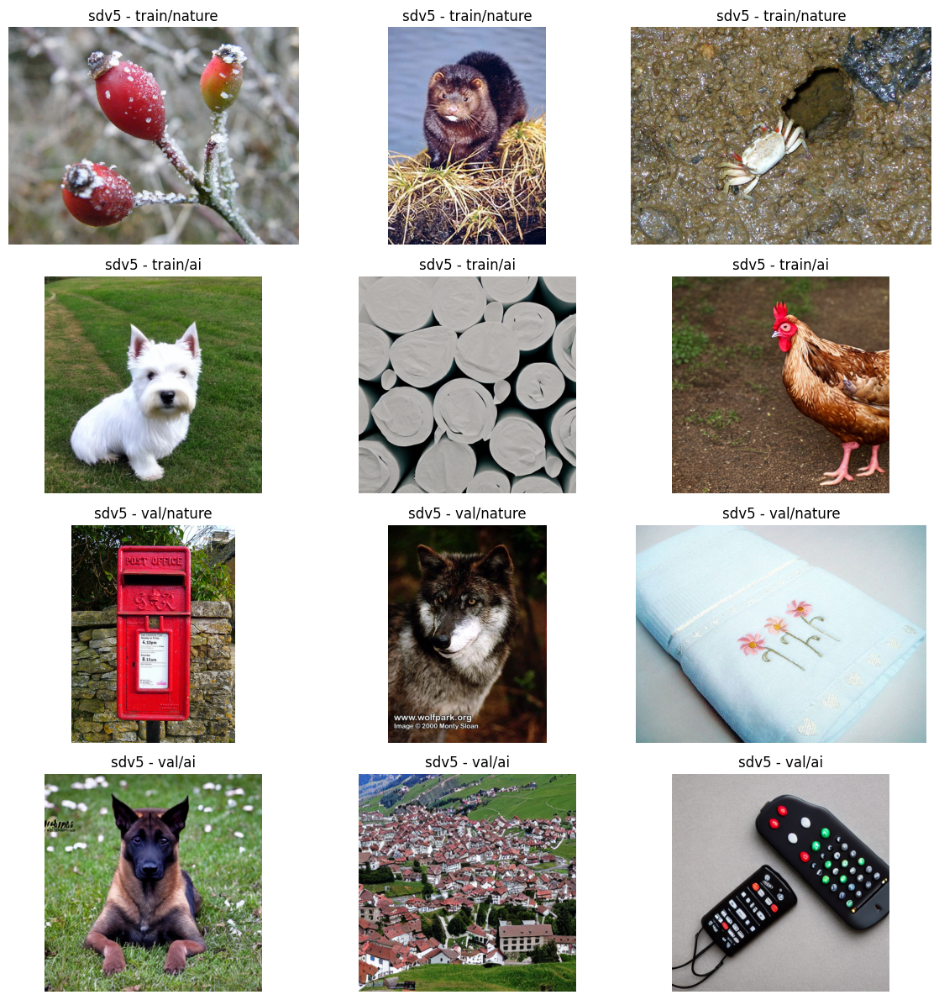

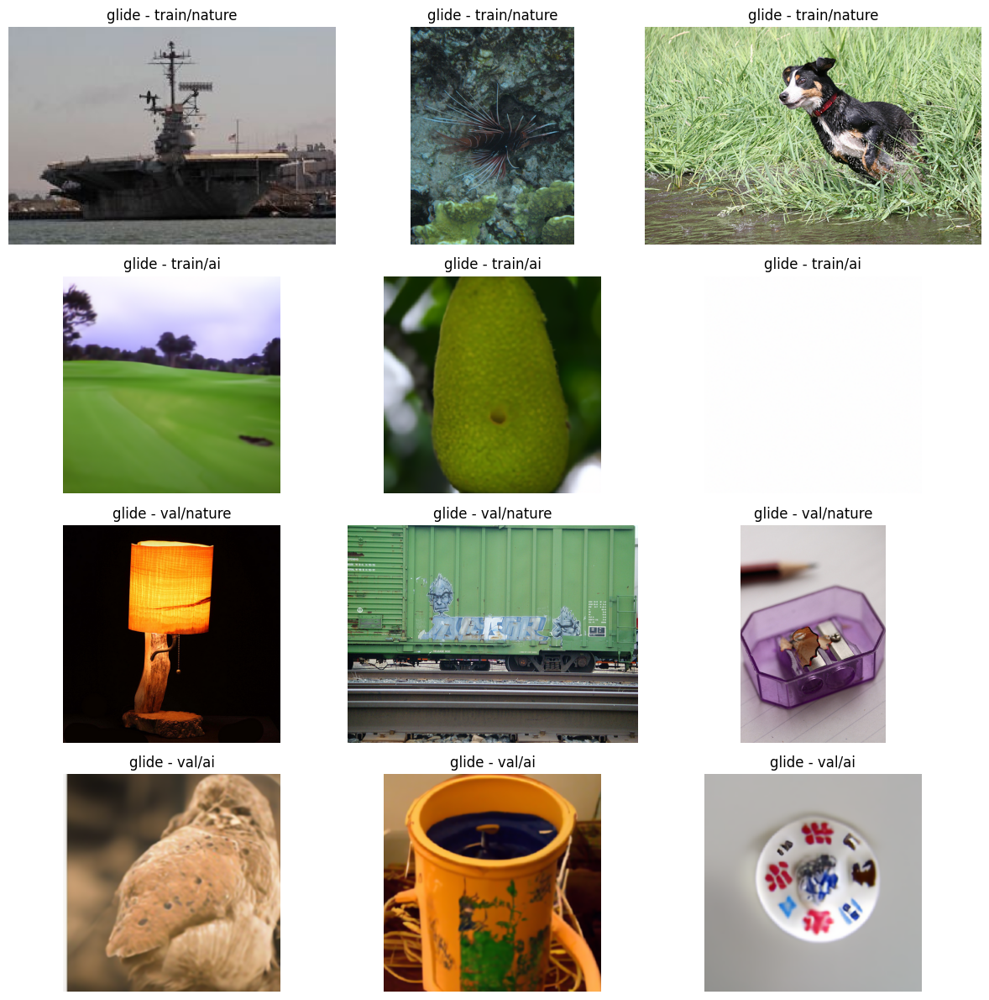

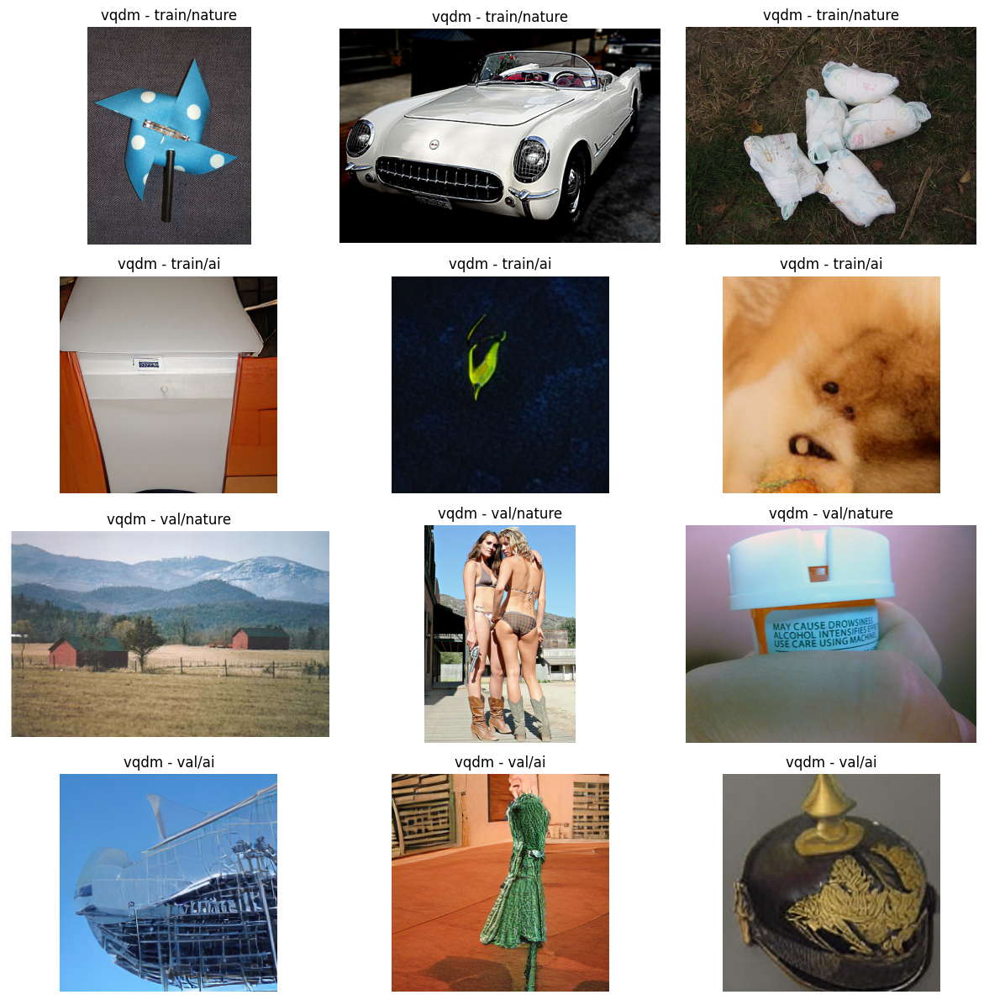

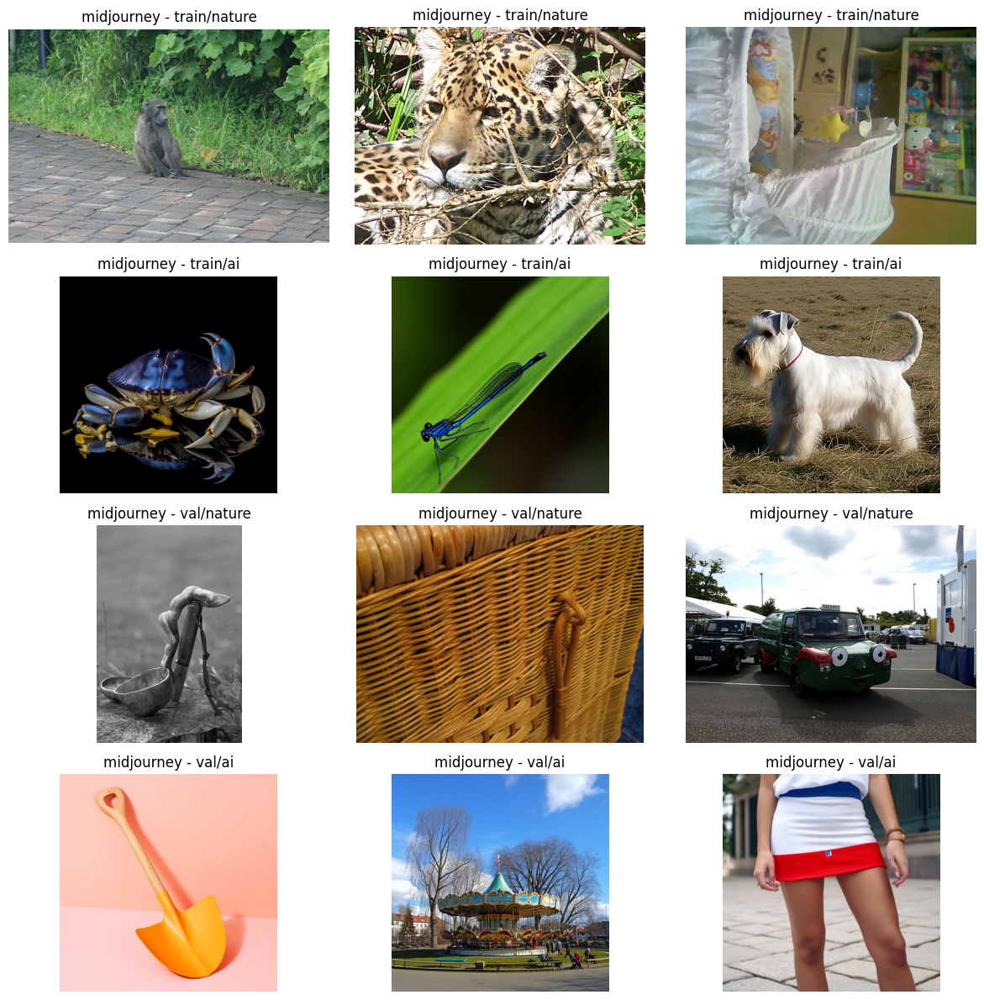

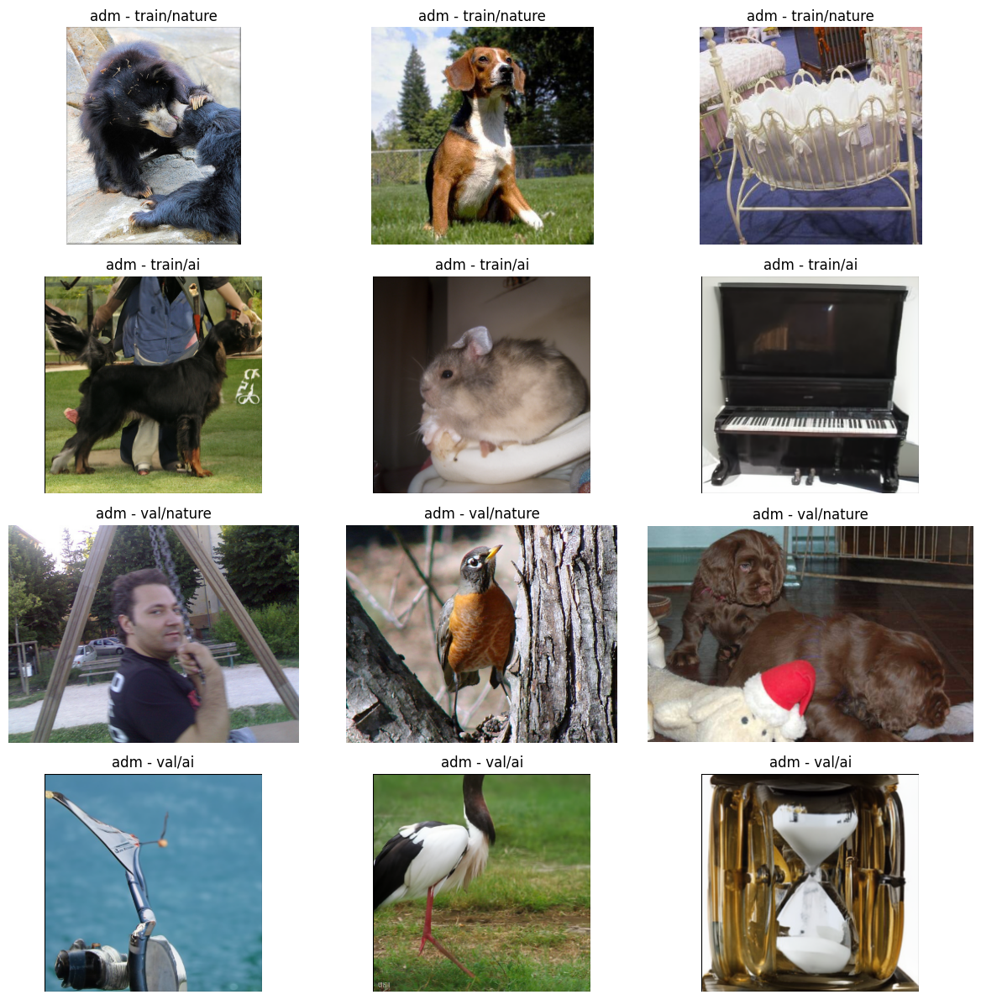

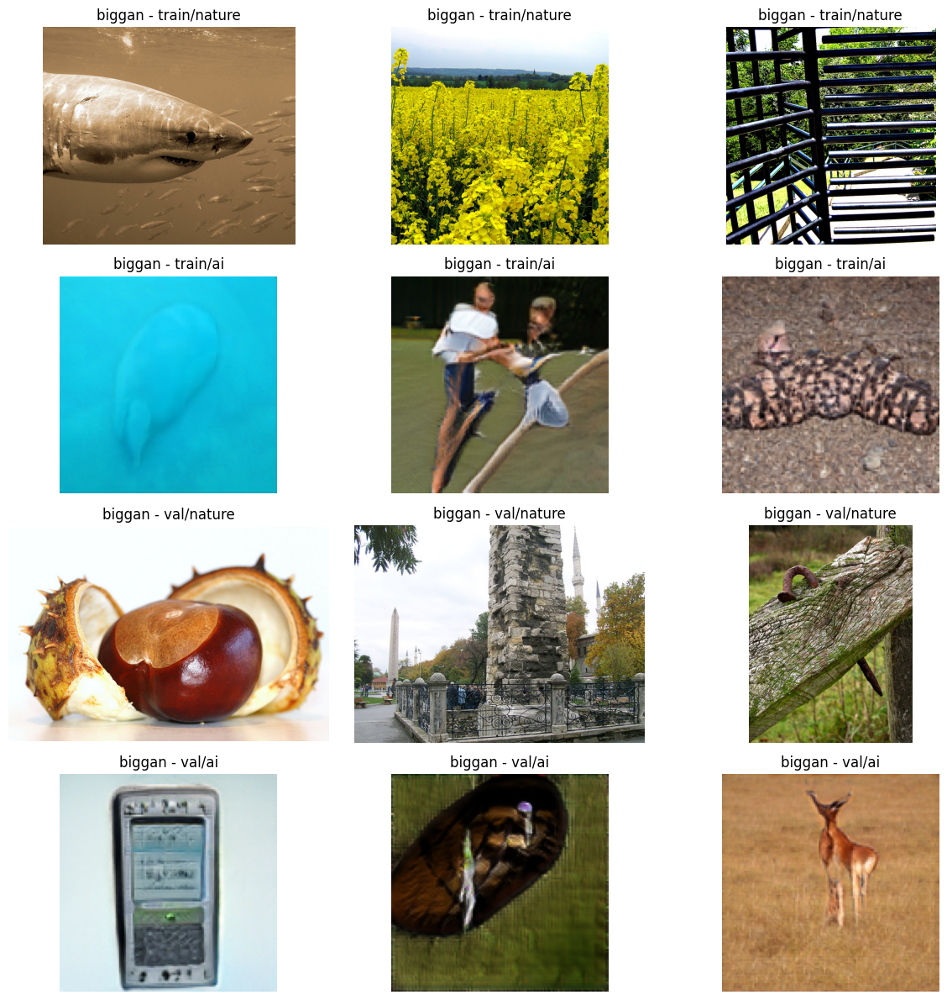

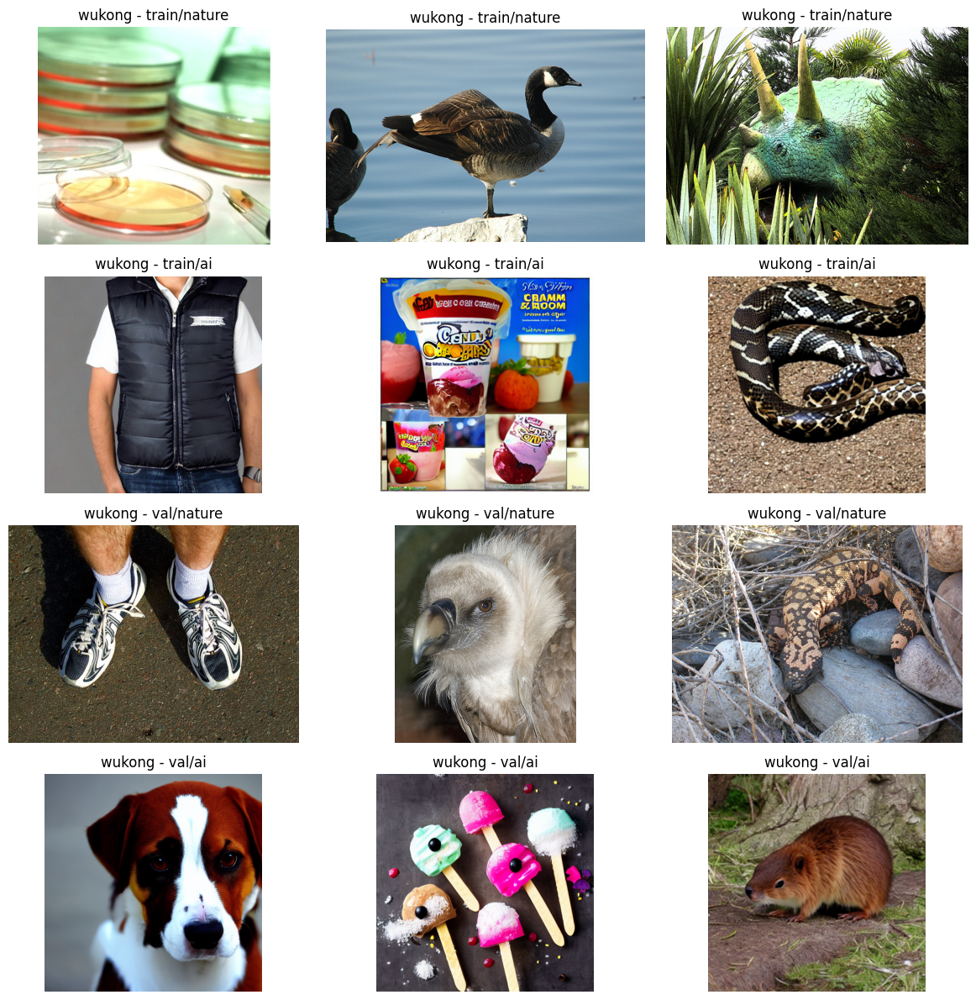

In [ ]:
import os
from pathlib import Path
import matplotlib.pyplot as plt
import random
from PIL import Image
from collections import defaultdict

# Paths
RAW_DIR = Path("../data/standardized_jpg")
PREVIEW_SAVE = Path("../data/standardized_jpg/preview.png")

# Helper function: get all images case-insensitive
def get_image_files(folder: Path):
    exts = [".jpg", ".jpeg", ".png"]  # add more if needed
    return [f for f in folder.glob("**/*") if f.suffix.lower() in exts]

# Count images per dataset/split/class
detailed_counts = defaultdict(dict)

for dataset in RAW_DIR.iterdir():
    if dataset.is_dir():
        for split in ["train", "val"]:
            split_dir = dataset / split
            if not split_dir.exists():
                continue
            for class_dir in split_dir.iterdir():
                if class_dir.is_dir():
                    count = len(get_image_files(class_dir))
                    detailed_counts[dataset.name][f"{split}/{class_dir.name}"] = count

# Print counts
print("Detailed image counts per dataset/split/class:")
for dataset, splits in detailed_counts.items():
    print(f"\n{dataset}")
    for split_class, count in splits.items():
        print(f"   {split_class}: {count} images")

# Visualize sample images
n_samples = 3
for dataset, splits in detailed_counts.items():
    classes = list(splits.keys())
    fig, axes = plt.subplots(len(classes), n_samples, figsize=(12, 3 * len(classes)))

    # Handle case when there's only one class
    if len(classes) == 1:
        axes = [axes]

    for row, split_class in enumerate(classes):
        # Example: split_class = "train/nature"
        split, cls = split_class.split("/")
        image_files = get_image_files(RAW_DIR / dataset / split / cls)
        if len(image_files) == 0:
            continue
        sample_files = random.sample(image_files, min(n_samples, len(image_files)))

        for col, img_path in enumerate(sample_files):
            try:
                img = Image.open(img_path).convert("RGB")
                axes[row][col].imshow(img)
                axes[row][col].axis("off")
                axes[row][col].set_title(f"{dataset} - {split_class}")
            except Exception as e:
                print(f"Could not load {img_path}: {e}")

    plt.tight_layout()
    plt.savefig(PREVIEW_SAVE.parent / f"{dataset}_preview.png")
    plt.show()